# <center>**1. People Counter using Computer Vision**</center>

Object Detection is a common Computer Vision problem which deals with identifying and locating object of certain classes in the image. Interpreting the object localisation can be done in various ways, including creating a bounding box around the object or marking every pixel in the image which contains the object (called segmentation).


In [0]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"></form>''')

In [0]:
%%capture
%load_ext autoreload
%autoreload 2
! pip install --upgrade mxnet-cu100 gluoncv # download the libraries 
! pip3 install scipy==1.1.0
! pip install --upgrade google-cloud-vision
from gluoncv import model_zoo, data, utils
from matplotlib import pyplot as plt
import numpy as np
from PIL import Image
import mxnet as mx
import cv2
import gluoncv as gcv


model1="yolo3_darknet53_voc"
model2="yolo3_mobilenet1.0_voc"
net = model_zoo.get_model(model1, pretrained=True, ctx=mx.gpu(0))

image_url_1= "https://images-production.freetls.fastly.net/uploads/posts/image/146271/waiting-times.jpg?auto=compress&crop=faces,top&fit=crop&q=55&w=750&h=562"
image_url_2="https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcT6_9lFSG8sq9c460MpG2jtbr0AWEVpE31WbNGOan1BGxoUxJhw"
image_url_3="https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQ0PCXuWxdFi1mCJK2YtcgphpJT71u1vz41GZB0nuOnr1hiRjl0"
image_url_4="https://images.haarets.co.il/image/fetch/w_2200,h_1272,x_0,y_200,c_crop,g_north_west/w_609,h_343,q_auto,c_fill,f_auto/fl_any_format.preserve_transparency.progressive:none/https://www.haaretz.com/polopoly_fs/1.5712384.1515527058!/image/1018316866.jpg"
input_image= "image_input.jpg"
! wget --output-document={input_image} {image_url_1}
x, img = data.transforms.presets.yolo.load_test(input_image, short=512)

In [0]:
%%time
class_IDs, scores, bounding_boxs = net(x.as_in_context(mx.gpu(0)))

CPU times: user 44.7 ms, sys: 13.2 ms, total: 58 ms
Wall time: 42.3 ms


### Example 1

No of people detected in the image is 7


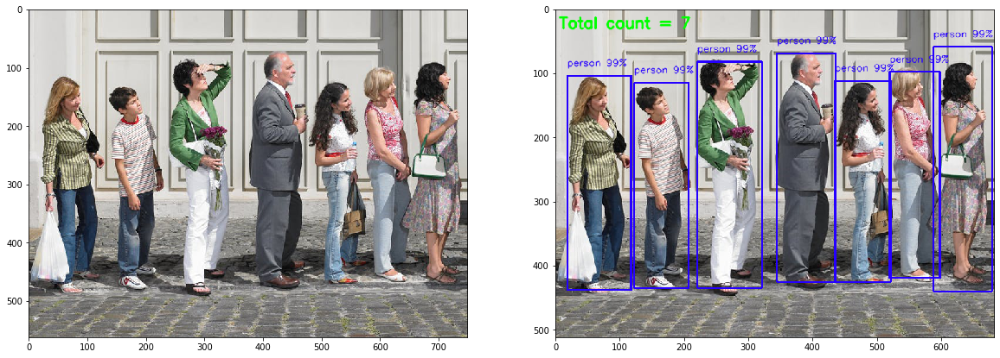

In [0]:
person_index=[index for index, elem in enumerate(class_IDs[0]) if elem ==14 and scores[0][index] >=0.95]
print("No of people detected in the image is {}".format(len(person_index)))
im_array = np.asarray(Image.open(input_image) )
fig = plt.figure(figsize=(20, 20)) # plt the images 
ax1 = fig.add_subplot(2,2,1)
plt.imshow(im_array)
ax2 = fig.add_subplot(2,2,2)
#utils.viz.plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index],
#                         class_IDs[0][person_index], class_names=net.classes, ax=ax2)
gcv.utils.viz.cv_plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index], class_IDs[0][person_index], class_names=net.classes)
font = cv2.FONT_HERSHEY_SIMPLEX
text="Total count = {}".format(len(person_index))
cv2.putText(img, text, (6,30), font, 0.8, (0, 255, 0), 2, cv2.LINE_AA)
plt.imshow(img)
plt.show()

### Example 2

In [0]:
%%capture
! wget --output-document={input_image} {image_url_4}

No of people detected in the image is 6


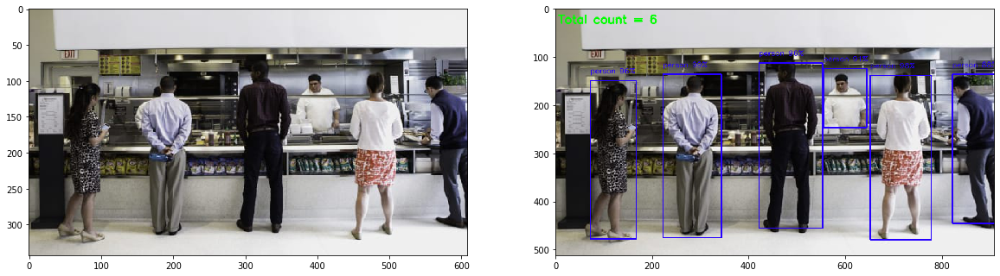

CPU times: user 1.19 s, sys: 742 ms, total: 1.93 s
Wall time: 7.59 s


In [0]:
%%time
x, img = data.transforms.presets.yolo.load_test(input_image, short=512)
class_IDs, scores, bounding_boxs = net(x.as_in_context(mx.gpu(0)))
person_index=[index for index, elem in enumerate(class_IDs[0]) if elem ==14 and scores[0][index] >=0.85]
print("No of people detected in the image is {}".format(len(person_index)))
im_array = np.asarray(Image.open(input_image) )
fig = plt.figure(figsize=(20, 20)) # plt the images 
ax1 = fig.add_subplot(2,2,1)
plt.imshow(im_array)
ax2 = fig.add_subplot(2,2,2)
#utils.viz.plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index],
#                         class_IDs[0][person_index], class_names=net.classes, ax=ax2)
gcv.utils.viz.cv_plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index], class_IDs[0][person_index], class_names=net.classes)

font = cv2.FONT_HERSHEY_SIMPLEX
text="Total count = {}".format(len(person_index))
cv2.putText(img, text, (6,30), font, 0.8, (0, 255, 0), 2, cv2.LINE_AA)
plt.imshow(img)
plt.show()

### Example 3

In [0]:
%%capture
! wget --output-document={input_image} {image_url_3}

No of people detected in the image is 8


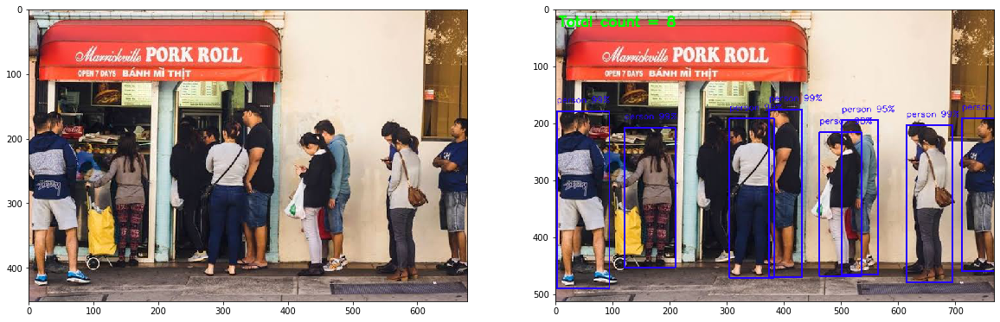

CPU times: user 1.21 s, sys: 744 ms, total: 1.96 s
Wall time: 7.52 s


In [0]:
%%time
x, img = data.transforms.presets.yolo.load_test(input_image, short=512)
class_IDs, scores, bounding_boxs = net(x.as_in_context(mx.gpu(0)))
person_index=[index for index, elem in enumerate(class_IDs[0]) if elem ==14 and scores[0][index] >=0.95]
print("No of people detected in the image is {}".format(len(person_index)))
im_array = np.asarray(Image.open(input_image) )
fig = plt.figure(figsize=(20, 20)) # plt the images 
ax1 = fig.add_subplot(2,2,1)
plt.imshow(im_array)
ax2 = fig.add_subplot(2,2,2)
#utils.viz.plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index],
#                         class_IDs[0][person_index], class_names=net.classes, ax=ax2)
gcv.utils.viz.cv_plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index], class_IDs[0][person_index], class_names=net.classes)
font = cv2.FONT_HERSHEY_SIMPLEX
text="Total count = {}".format(len(person_index))
cv2.putText(img, text, (6,30), font, 0.8, (0, 255, 0), 2, cv2.LINE_AA)
plt.imshow(img)
plt.show()

## Live Demonstration using webcam feed

In [0]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

No of people detected in the image is 1


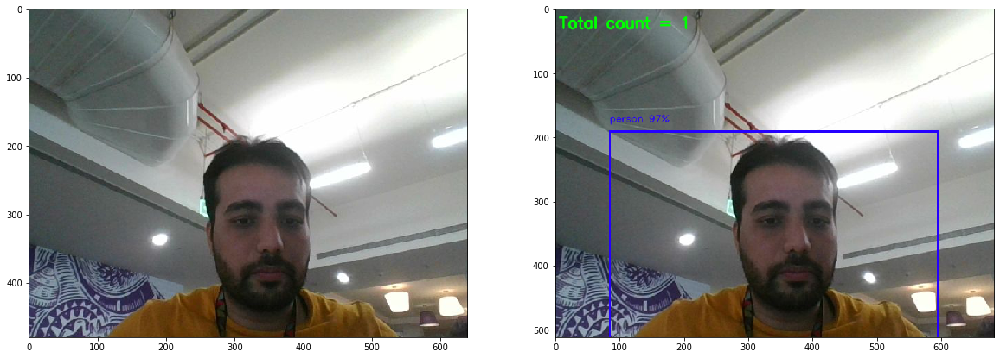

CPU times: user 1.29 s, sys: 80.6 ms, total: 1.37 s
Wall time: 6.56 s


In [0]:
%%time
take_photo(input_image)
x, img = data.transforms.presets.yolo.load_test(input_image, short=512)
class_IDs, scores, bounding_boxs = net(x.as_in_context(mx.gpu(0)))
person_index=[index for index, elem in enumerate(class_IDs[0]) if elem ==14]
print("No of people detected in the image is {}".format(len(person_index)))
im_array = np.asarray(Image.open(input_image) )
fig = plt.figure(figsize=(20, 20)) # plt the images 
ax1 = fig.add_subplot(2,2,1)
plt.imshow(im_array)
ax2 = fig.add_subplot(2,2,2)
font = cv2.FONT_HERSHEY_SIMPLEX
text="Total count = {}".format(len(person_index))
gcv.utils.viz.cv_plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index], class_IDs[0][person_index], class_names=net.classes)
cv2.putText(img, text, (6,30), font, 0.8, (0, 255, 0), 2, cv2.LINE_AA)
#utils.viz.plot_bbox(img, bounding_boxs[0][person_index], scores[0][person_index],
#                         class_IDs[0][person_index], class_names=net.classes, ax=ax2)
plt.imshow(img)
plt.show()



<br>

# <center>**2. Emotion Detection using Computer Vision**</center>

In [0]:
%%capture
from google.colab import drive
drive.mount('/content/drive')
! cp -r drive/'My Drive'/face_classification .
! cp drive/'My Drive'/video.mp4 .
! cp drive/'My Drive'/video_2.mp4 .
! cp drive/'My Drive'/video_3.mp4 .

### Example 1

In [0]:
%%capture
image_url_1= "https://st2.depositphotos.com/3261171/10699/i/950/depositphotos_106996320-stock-photo-nice-friends-talking.jpg"
image_url_2="https://www.reviewgeek.com/thumbcache/0/0/be2c0f5edf65461e0992aca6c6afaffe/p/uploads/2018/03/x586b1b59.jpg.pagespeed.gp+jp+jw+pj+ws+js+rj+rp+rw+ri+cp+md.ic.UMvX_Gs-mk.jpg"
image_url_3="https://theskincareedit.com/.image/t_share/MTU2ODk4MzU2OTU0MzQzMDI0/chloe-moretz-inverted-triangle-face-bangs.jpg"
input_image= "image_input_face.jpg"


! wget --output-document={input_image} {image_url_3}
image_dir="../../"+input_image
! cd face_classification/src ; python3 image_emotion_gender_demo.py {image_dir}


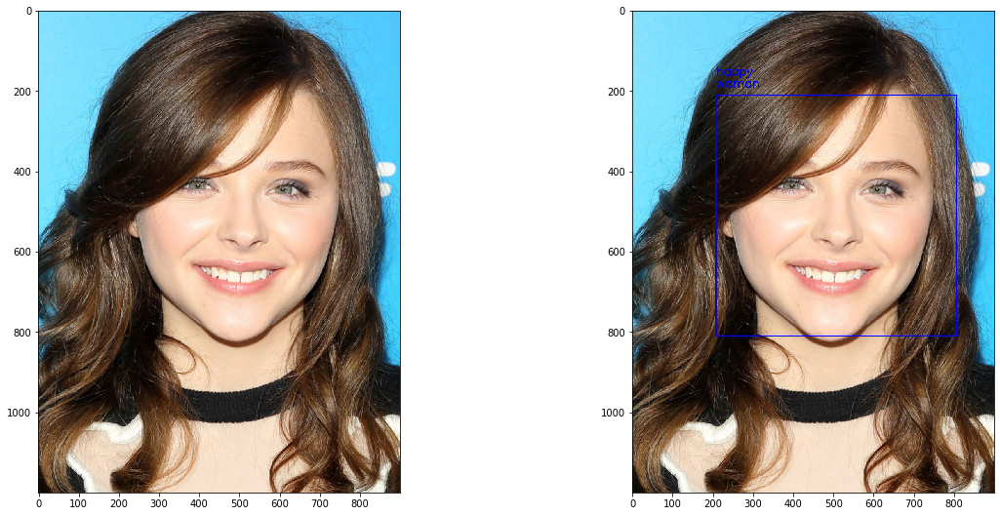

In [0]:
im_array = np.asarray(Image.open(input_image) )
fig = plt.figure(figsize=(20, 20)) # plt the images 
ax1 = fig.add_subplot(2,2,1)
plt.imshow(im_array)
ax2 = fig.add_subplot(2,2,2)
plt.imshow(plt.imread("face_classification/src/output.jpg"))
plt.show()

### Example 2

In [0]:
%%capture
! wget --output-document={input_image} {image_url_1}
image_dir="../../"+input_image
! cd face_classification/src ; python3 image_emotion_gender_demo.py {image_dir}

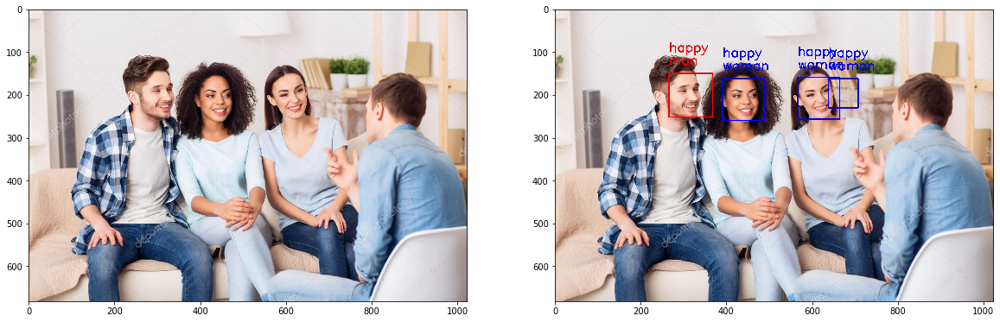

In [0]:
im_array = np.asarray(Image.open(input_image) )
fig = plt.figure(figsize=(20, 20)) # plt the images 
ax1 = fig.add_subplot(2,2,1)
plt.imshow(im_array)
ax2 = fig.add_subplot(2,2,2)
plt.imshow(plt.imread("face_classification/src/output.jpg"))
plt.show()

<br>

# <center>**3. People Counter on Video**</center>

### Lets view the original video

In [0]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [0]:
writer=None
font = cv2.FONT_HERSHEY_SIMPLEX
cap = cv2.VideoCapture("video.mp4")
frame_count=1
#width=int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
#height=int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps=cap.get(cv2.CAP_PROP_FPS)
#width=910
#height=512

#fourcc = cv2.VideoWriter_fourcc(*"XVID")
#writer = cv2.VideoWriter("Output_video.mp4", fourcc, fps, 
#                          (width, height))


while True:
  if frame_count %50==0:
    print("Processing frame {}".format(frame_count))
  frame_count+=1

  
  ret, frame = cap.read()
  if not ret:
    break

  x, img = data.transforms.presets.yolo.transform_test(mx.nd.array(frame), short=512)
  if writer is None:
    width=img.shape[1]
    height=img.shape[0]
    fourcc = cv2.VideoWriter_fourcc(*"XVID")
    writer = cv2.VideoWriter("Output_video.mp4", fourcc, fps, 
                          (width, height))
  class_IDs, scores, bounding_boxes = net(x.as_in_context(mx.gpu(0)))
  person_index=[index for index, elem in enumerate(class_IDs[0]) if elem ==14 and scores[0][index] >=0.95]
  #img = gcv.utils.viz.cv_plot_bbox(frame, bounding_boxes[0][person_index], scores[0][person_index], class_IDs[0][person_index], class_names=net.classes)
  gcv.utils.viz.cv_plot_bbox(img, bounding_boxes[0][person_index], scores[0][person_index], class_IDs[0][person_index], class_names=net.classes)
  text="Total count = {}".format(len(person_index))
  cv2.putText(img, text, (6,30), font, 0.8, (0, 255, 0), 2, cv2.LINE_AA)
  writer.write(img)
print ("[INFO] Cleaning up...")
writer.release()
cap.release()

Processing frame 50
Processing frame 100
Processing frame 150
Processing frame 200
Processing frame 250
Processing frame 300
Processing frame 350
Processing frame 400
[INFO] Cleaning up...


### Lets see the processed video

In [0]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('Output_video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# <center>**4. Object Detection using Google cloud vision API**</center>

To use the Google cloud vision api you need to generate api credentials, download the json file and place the json file as cred.json in the current working directory.

In [0]:
%%capture
%env GOOGLE_APPLICATION_CREDENTIALS=/content/cred.json

In [0]:
%%capture
image_url_1= "https://images-production.freetls.fastly.net/uploads/posts/image/146271/waiting-times.jpg?auto=compress&crop=faces,top&fit=crop&q=55&w=750&h=562"
image_url_2="https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcT6_9lFSG8sq9c460MpG2jtbr0AWEVpE31WbNGOan1BGxoUxJhw"
image_url_3="https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQ0PCXuWxdFi1mCJK2YtcgphpJT71u1vz41GZB0nuOnr1hiRjl0"
image_url_4="https://images.haarets.co.il/image/fetch/w_2200,h_1272,x_0,y_200,c_crop,g_north_west/w_609,h_343,q_auto,c_fill,f_auto/fl_any_format.preserve_transparency.progressive:none/https://www.haaretz.com/polopoly_fs/1.5712384.1515527058!/image/1018316866.jpg"
input_image= "image_input.jpg"
! wget --output-document={input_image} {image_url_1}

Number of people detetcted in image: 6




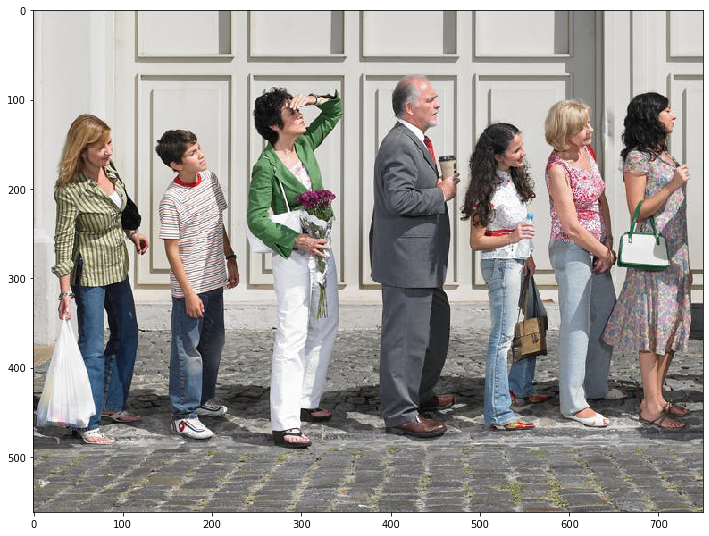

In [0]:
from google.cloud import vision
client = vision.ImageAnnotatorClient()

with open(input_image, 'rb') as image_file:
      content = image_file.read()
image = vision.types.Image(content=content)

img=plt.imread(input_image)
width=img.shape[0]
height=img.shape[1]


objects = client.object_localization(
        image=image,max_results=100).localized_object_annotations


filter_objects =[ob for ob in objects if ob.name in ["Person", "Woman","Man"]]
print('Number of people detetcted in image: {}'.format(len(filter_objects)))
print("\n")
plt.figure(figsize=(12, 12))
plt.imshow(img)
plt.show()

# <center>**5. Emotion Detection using Google cloud vision API**</center>

In [0]:
from google.cloud import vision
import io

def emotion_cloud_vision(input_image):
  img= plt.imread(input_image)

  client = vision.ImageAnnotatorClient()

  with io.open(input_image, 'rb') as image_file:
      content = image_file.read()

  image = vision.types.Image(content=content)

  response = client.face_detection(image=image)
  faces = response.face_annotations

  # Names of likelihood from google.cloud.vision.enums
  likelihood_name = ('UNKNOWN', 'VERY_UNLIKELY', 'UNLIKELY', 'POSSIBLE',
                        'LIKELY', 'VERY_LIKELY')
  anger_count=0
  joy_count=0
  suprise_count=0

  for face in faces:
      #print('anger: {}'.format(likelihood_name[face.anger_likelihood]))
      #print('joy: {}'.format(likelihood_name[face.joy_likelihood]))
      #print('surprise: {}'.format(likelihood_name[face.surprise_likelihood]))
      emotion_text= None

      if likelihood_name[face.anger_likelihood] in ["LIKELY", "VERY_LIKELY"]:
        emotion_text='anger: {}'.format(likelihood_name[face.anger_likelihood])
        anger_count+=1
      elif likelihood_name[face.joy_likelihood] in ["LIKELY", "VERY_LIKELY"]:
        emotion_text='joy: {}'.format(likelihood_name[face.joy_likelihood])
        joy_count+=1
      elif likelihood_name[face.surprise_likelihood] in ["LIKELY", "VERY_LIKELY"]:
        emotion_text='surprise: {}'.format(likelihood_name[face.surprise_likelihood])
        suprise_count+=1
      
      vertices = (['{},{}'.format(vertex.x, vertex.y)
                      for vertex in face.bounding_poly.vertices])

    
      start_x=int(vertices[0].split(",")[0])
      start_y=int(vertices[0].split(",")[1])
      w=int(vertices[1].split(",")[0])-int(vertices[0].split(",")[0])
      h=int(vertices[3].split(",")[1])-int(vertices[0].split(",")[1])

      cv2.rectangle(img,(start_x,start_y),(start_x+w,start_y+h),(0,255,0),2)
      #text1='anger: {}'.format(likelihood_name[face.anger_likelihood])
      #text2='joy: {}'.format(likelihood_name[face.joy_likelihood])
      #text3='surprise: {}'.format(likelihood_name[face.surprise_likelihood])

      cv2.putText(img, emotion_text, (start_x+5,start_y-20), font, 0.6, (0, 255, 0), 2, cv2.LINE_AA)
      #cv2.putText(img, text1, (start_x+5,start_y-80), font, 0.5, (0, 255, 0), 2, cv2.LINE_AA)
      #cv2.putText(img, text2, (start_x+5,start_y-50), font, 0.5, (0, 255, 0), 2, cv2.LINE_AA)
      #cv2.putText(img, text3, (start_x+5,start_y-20), font, 0.5, (0, 255, 0), 2, cv2.LINE_AA)
      #print(start_x, start_y, w,h)
      #print('face bounds: {}'.format(','.join(vertices)))

  print("There are {} angry faces , {} joy faces , {} suprise faces".format(anger_count,joy_count, suprise_count ))

  cv2.putText(img, "{} angry faces , {} joy faces , {} suprise faces".format(anger_count,joy_count, suprise_count), (6,30), font, 0.8, (0, 255, 0), 2, cv2.LINE_AA)
  fig = plt.figure(figsize=(15, 15))
  plt.imshow(img)


In [0]:
%%capture
image_url_1= "https://st2.depositphotos.com/3261171/10699/i/950/depositphotos_106996320-stock-photo-nice-friends-talking.jpg"
input_image= "image_input.jpg"
! wget --output-document={input_image} {image_url_1}

There are 0 angry faces , 3 joy faces , 0 suprise faces


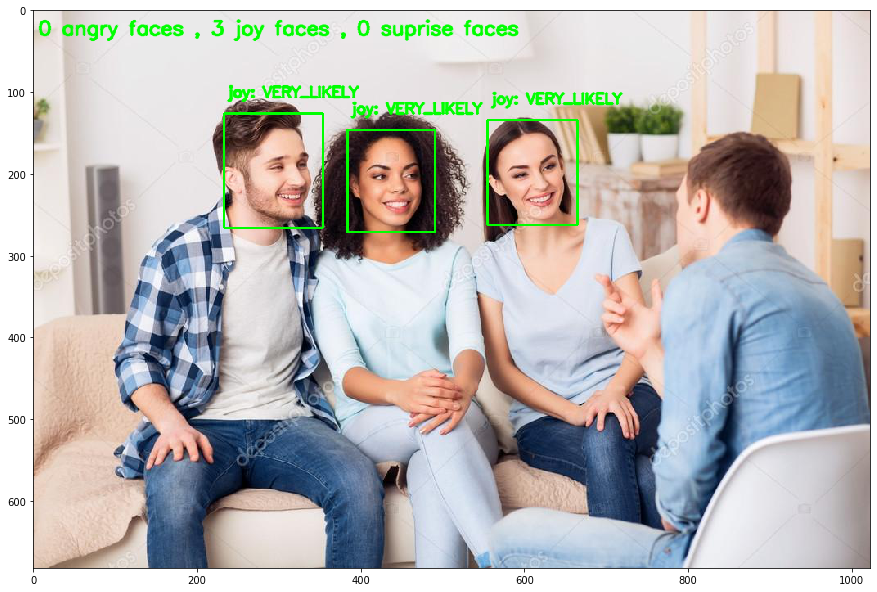

In [0]:
emotion_cloud_vision(input_image)

In [0]:
%%capture
image_url_1= "https://ak8.picdn.net/shutterstock/videos/243658/thumb/1.jpg"
input_image= "image_input.jpg"
! wget --output-document={input_image} {image_url_1}

There are 0 angry faces , 3 joy faces , 0 suprise faces


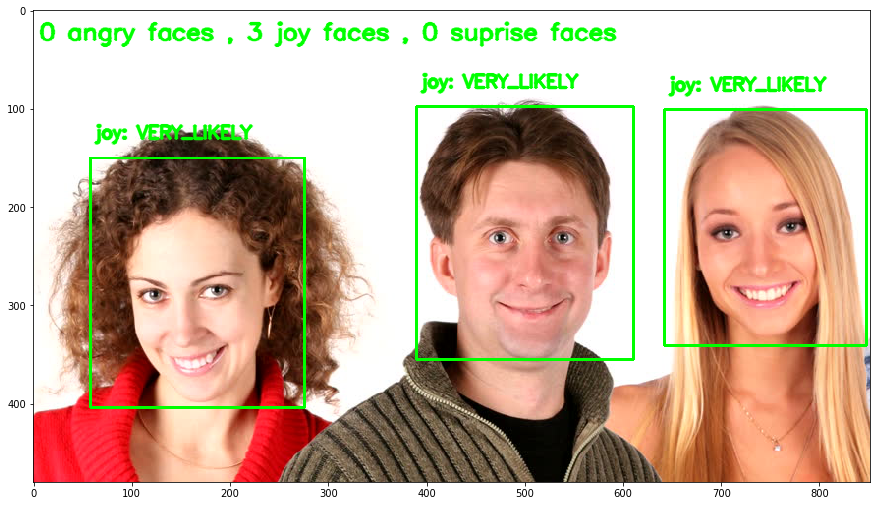

In [0]:
emotion_cloud_vision(input_image)

<IPython.core.display.Javascript object>

There are 0 angry faces , 1 joy faces , 0 suprise faces


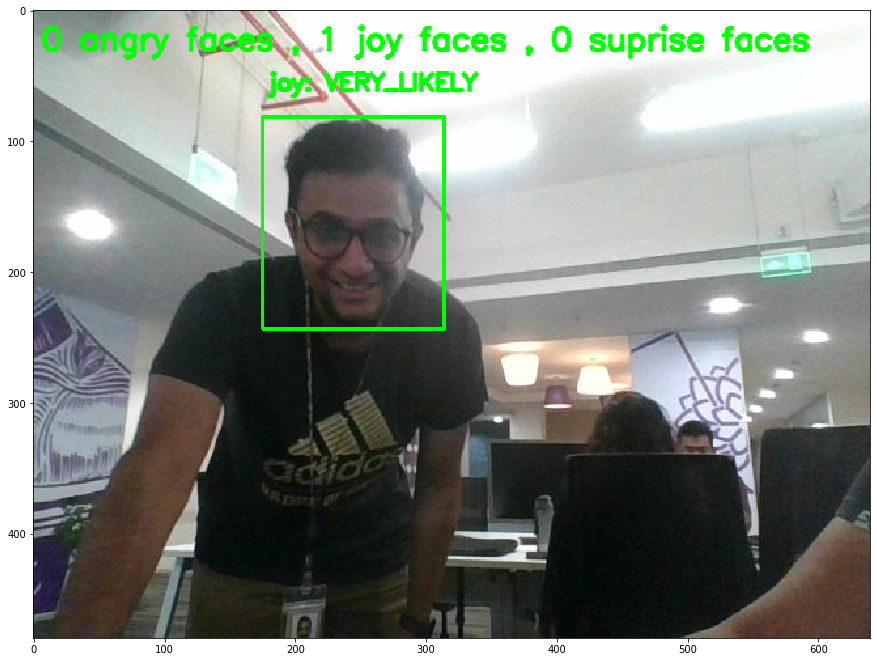

In [0]:
take_photo(input_image)
emotion_cloud_vision(input_image)

<figure>
<center>
<img src='https://media.giphy.com/media/l3q2FnW3yZRJVZH2g/giphy.gif' />
</center>
</figure>